In [22]:
import tifffile as tiff
import numpy as np
import matplotlib.pyplot as plt
import math

In [23]:
def load_tif_image(file_path):
    """load a  TIF adn return a  NumPy array."""
    with tiff.TiffFile(file_path) as tif:
        image = tif.asarray()
    return image

def load_image(file_path):
    """Load an image file and return a NumPy array."""
    with Image.open(file_path) as img:
        image = np.array(img)
    return image[:, :, 0]  

In [24]:
def split_into_grids(image, grid_size):
    """Split the image into grids of specified size and return a list of grids with pixel data and coordinates."""
    num_rows = (image.shape[0] + grid_size - 1) // grid_size
    num_cols = (image.shape[1] + grid_size - 1) // grid_size
    grids = []
    for i in range(num_rows):
        for j in range(num_cols):
            start_row = i * grid_size
            end_row = min(start_row + grid_size, image.shape[0])
            start_col = j * grid_size
            end_col = min(start_col + grid_size, image.shape[1])
            grid = image[start_row:end_row, start_col:end_col]
            mean_pixel_value = np.mean(grid)
            grids.append((grid, mean_pixel_value, (start_row, start_col)))
    return grids

def visualize_clusters(grids, labels):
    """Visualize all grids in each cluster along with their coordinates."""
    unique_labels = set(labels)
    for label in unique_labels:
        cluster_grids_coords = [(grid[0], grid[2]) for grid, cluster_label in zip(grids, labels) if cluster_label == label]
        num_grids = len(cluster_grids_coords)
        cols = 10
        rows = math.ceil(num_grids / cols)
        fig, axs = plt.subplots(rows, cols, figsize=(20, 2 * rows))
        fig.suptitle(f"Cluster {label + 1} - Total grids: {num_grids}", fontsize=16)
        for ax, (grid, coords) in zip(axs.flatten(), cluster_grids_coords):
            ax.imshow(grid, cmap='gray')
            ax.axis('off')
            ax.set_title(f"Coords: {coords}", fontsize=8)
        for ax in axs.flatten()[num_grids:]:
            ax.axis('off')
        plt.tight_layout()
        plt.subplots_adjust(top=0.92)
        plt.show()

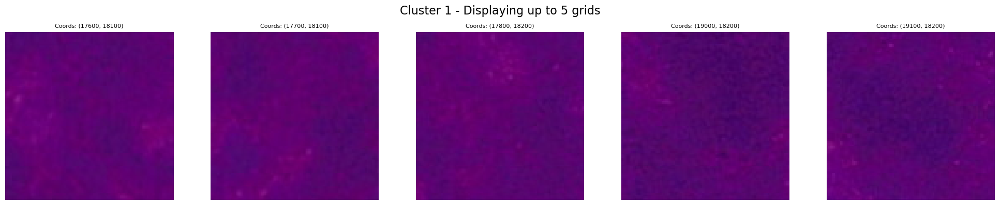

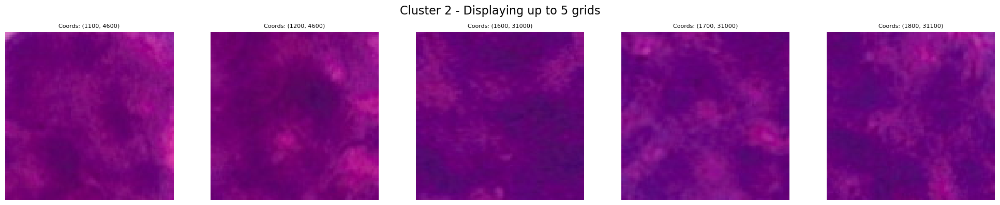

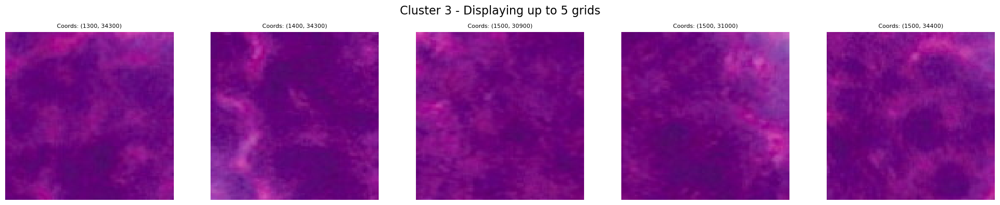

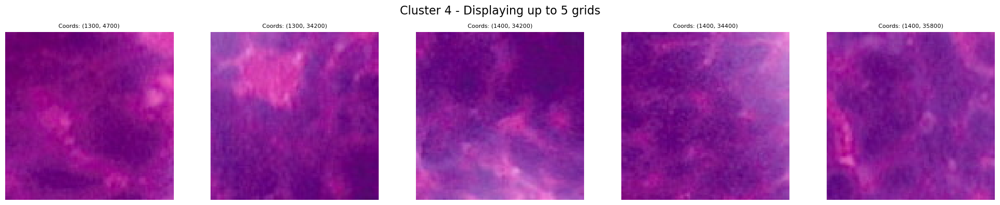

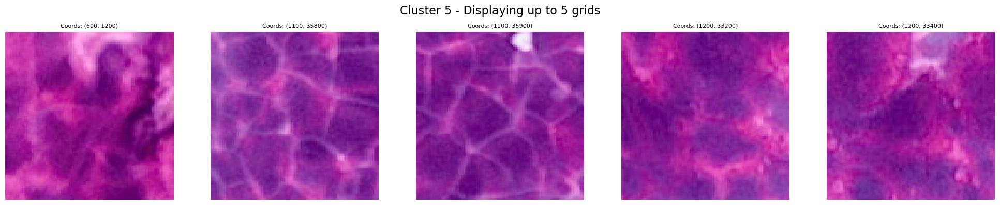

...

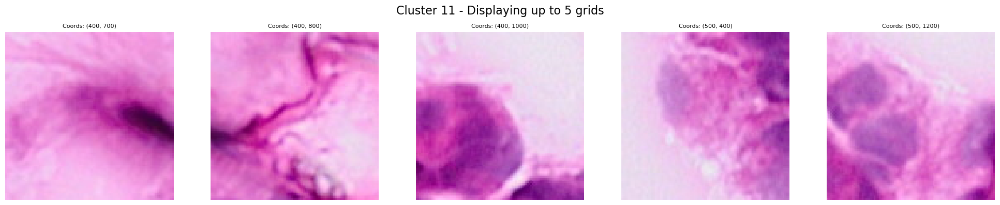

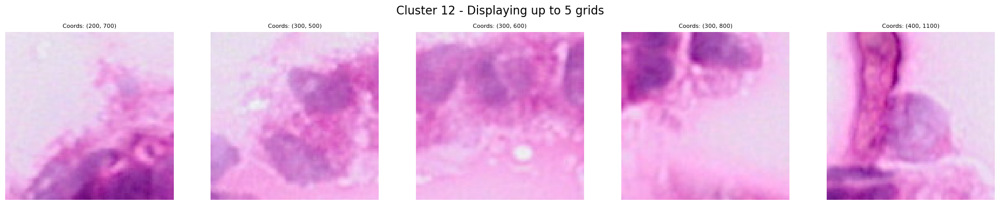

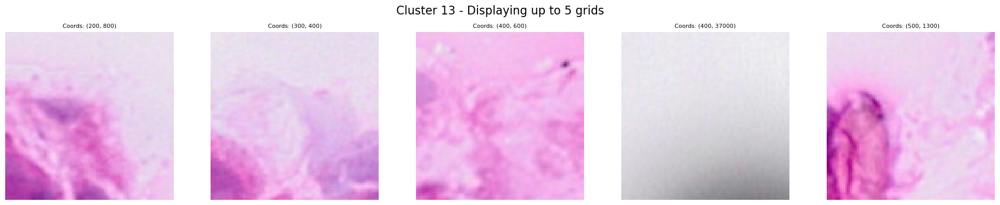

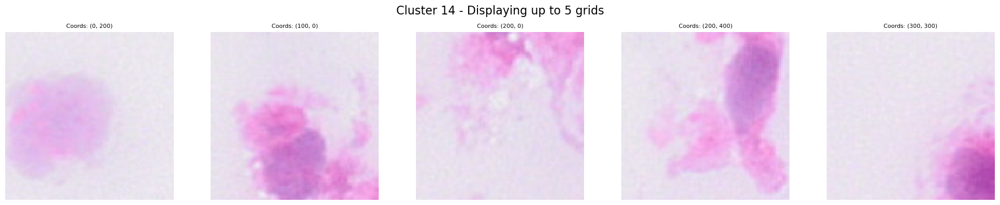

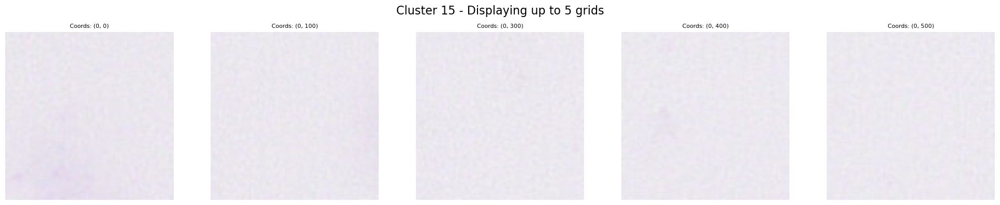

In [25]:
def classify_grids(grids, num_clusters=10, background_threshold=240):
    """Cluster grids into categories based on their mean pixel values, excluding the white background."""
    thresholds = np.linspace(min(grid[1] for grid in grids), max(grid[1] for grid in grids), num_clusters + 1)
    labels = np.digitize([grid[1] for grid in grids], thresholds)
    
    # Reclassify grids with mean pixel values above the background threshold as a background cluster
    labels = np.where([grid[1] > background_threshold for grid in grids], num_clusters, labels - 1)
    
    return labels
def visualize_clusters_first(grids, labels, max_per_cluster=5, exclude_label=None):
    """Visualize a limited number of grids from each cluster along with their coordinates, excluding specified cluster."""
    unique_labels = set(labels)
    for label in unique_labels:
        if exclude_label is not None and label == exclude_label:
            continue  # Skip the cluster labeled as background

        cluster_grids_coords = [(grid[0], grid[2]) for grid, cluster_label in zip(grids, labels) if cluster_label == label]
        
        limited_grids_coords = cluster_grids_coords[:max_per_cluster]
        num_grids = len(limited_grids_coords)
        
        cols = min(num_grids, 5)
        rows = 1
        
        fig, axs = plt.subplots(rows, cols, figsize=(cols * 4, 4))
        if cols == 1:
            axs = [axs]  
        fig.suptitle(f"Cluster {label + 1} - Displaying up to {max_per_cluster} grids", fontsize=16)

        for ax, (grid, coords) in zip(axs, limited_grids_coords):
            ax.imshow(grid, cmap='gray')
            ax.axis('off')
            ax.set_title(f"Coords: {coords}", fontsize=8)
        
        for ax in axs[num_grids:]:
            ax.axis('off')
        
        plt.tight_layout()
        plt.subplots_adjust(top=0.85)
        plt.show()
def main():
    file_path = '/mnt/plummergrp/Yutian/Project/SJEA09_C17_head_20x.tiff'  # Ensure the file is a PNG and update path as needed
    grid_size = 100
    num_clusters = 15
    background_threshold = 300 
    image = load_tif_image(file_path)
    grids = split_into_grids(image, grid_size)
    labels = classify_grids(grids, num_clusters=num_clusters, background_threshold=background_threshold)
    visualize_clusters_first(grids, labels, exclude_label=num_clusters)

if __name__ == '__main__':
    main()

In [26]:
def visualize_cluster_10(grids, labels):
    """Visualize all grids from cluster 10 along with their coordinates."""
    target_cluster = 10
    cluster_grids_coords = [(grid[0], grid[2]) for grid, cluster_label in zip(grids, labels) if cluster_label == target_cluster]
    
    num_grids = len(cluster_grids_coords)
    
    cols = 10  # Adjust the number of columns to display
    rows = math.ceil(num_grids / cols)  # Calculate the number of rows needed
    
    fig, axs = plt.subplots(rows, cols, figsize=(20, 2 * rows))
    fig.suptitle(f"Cluster {target_cluster} - Total grids: {num_grids}", fontsize=16)
    
    for ax, (grid, coords) in zip(axs.flatten(), cluster_grids_coords):
        ax.imshow(grid, cmap='gray')
        ax.axis('off')
        ax.set_title(f"Coords: {coords}", fontsize=8)
    
    for ax in axs.flatten()[num_grids:]:
        ax.axis('off')
    
    plt.tight_layout()
    plt.subplots_adjust(top=0.92)
    plt.show()
    
    return cluster_grids_coords  # Return coordinates for marking on the original image
def visualize_cluster_10_in_batches(grids, labels, batch_size=50):
    """Visualize all grids from cluster 10 in batches to avoid memory issues."""
    target_cluster = 10
    cluster_grids_coords = [(grid[0], grid[2]) for grid, cluster_label in zip(grids, labels) if cluster_label == target_cluster]
    
    num_grids = len(cluster_grids_coords)
    num_batches = math.ceil(num_grids / batch_size)
    
    for batch in range(num_batches):
        batch_grids_coords = cluster_grids_coords[batch * batch_size:(batch + 1) * batch_size]
        cols = 10  # Adjust the number of columns
        rows = math.ceil(len(batch_grids_coords) / cols)
        
        fig, axs = plt.subplots(rows, cols, figsize=(20, 2 * rows))
        fig.suptitle(f"Cluster 10 - Grids {batch * batch_size + 1} to {(batch + 1) * batch_size}", fontsize=16)
        
        for ax, (grid, coords) in zip(axs.flatten(), batch_grids_coords):
            ax.imshow(grid, cmap='gray')
            ax.axis('off')
            ax.set_title(f"Coords: {coords}", fontsize=8)
        
        for ax in axs.flatten()[len(batch_grids_coords):]:
            ax.axis('off')
        
        plt.tight_layout()
        plt.subplots_adjust(top=0.92)
        plt.show()
    
    return cluster_grids_coords  # Return coordinates for marking on the original image
def visualize_cluster_10_with_smaller_figures(grids, labels):
    """Visualize all grids from cluster 10 with reduced figure size to avoid memory issues."""
    target_cluster = 10
    cluster_grids_coords = [(grid[0], grid[2]) for grid, cluster_label in zip(grids, labels) if cluster_label == target_cluster]
    
    num_grids = len(cluster_grids_coords)
    
    cols = 5  # Reduce the number of columns to reduce the figure width
    rows = math.ceil(num_grids / cols)
    
    fig, axs = plt.subplots(rows, cols, figsize=(4 * cols, 4 * rows))  # Adjust figure size dynamically
    fig.suptitle(f"Cluster {target_cluster} - Total grids: {num_grids}", fontsize=16)
    
    for ax, (grid, coords) in zip(axs.flatten(), cluster_grids_coords):
        ax.imshow(grid, cmap='gray')
        ax.axis('off')
        ax.set_title(f"Coords: {coords}", fontsize=8)
    
    for ax in axs.flatten()[num_grids:]:
        ax.axis('off')
    
    plt.tight_layout()
    plt.subplots_adjust(top=0.92)
    plt.show()
    
    return cluster_grids_coords  # Return coordinates for marking on the original image
def count_grids_in_cluster(labels, target_cluster):
    """Count the number of grids in a specific cluster."""
    return sum(1 for label in labels if label == target_cluster)

# def main():
#     file_path = '/mnt/plummergrp/Yutian/Project/SJEA09_C17_head_20x.tiff'
#     grid_size = 100
#     num_clusters = 15
#     background_threshold = 250
    
#     image = load_tif_image(file_path)
#     grids = split_into_grids(image, grid_size)
#     labels = classify_grids(grids, num_clusters=num_clusters, background_threshold=background_threshold)
    
#     # Count the number of grids in cluster 10
#     cluster_10_count = count_grids_in_cluster(labels, 10)
#     print(f"Cluster 10 contains {cluster_10_count} grids.")
    
#     # Visualize all grids from cluster 10
#     cluster_10_coords = visualize_cluster_10_in_batches(grids, labels)

#     # Mark cluster 10 grids on the original image
#     mark_cluster_10_on_image(image, cluster_10_coords, grid_size)

# if __name__ == '__main__':
#     main()

In [27]:
def mark_cluster_10_on_image(image, cluster_grids_coords, grid_size):
    """Mark all grids from cluster 10 on the large image."""
    plt.figure(figsize=(10, 10))
    plt.imshow(image, cmap='gray')
    
    for _, coords in cluster_grids_coords:
        start_row, start_col = coords
        rect = plt.Rectangle((start_col, start_row), grid_size, grid_size, edgecolor='red', facecolor='none', lw=2)
        plt.gca().add_patch(rect)
    
    plt.title("Cluster 10 Grids Marked on Image")
    plt.axis('off')
    plt.show()

Cluster 10 contains 100 grids.


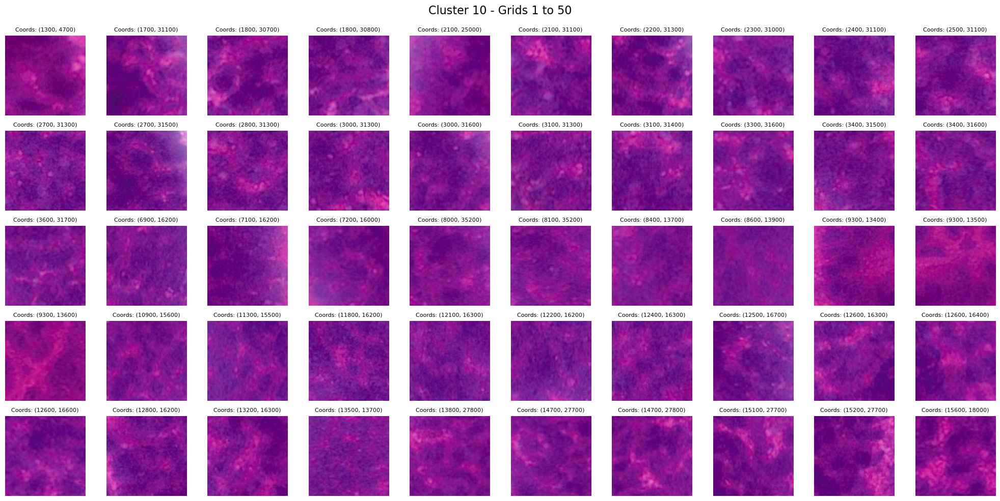

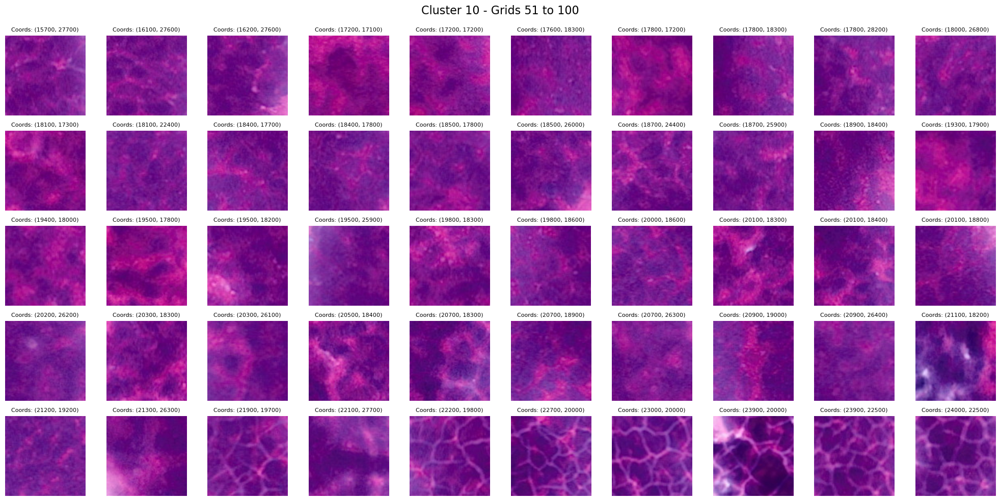

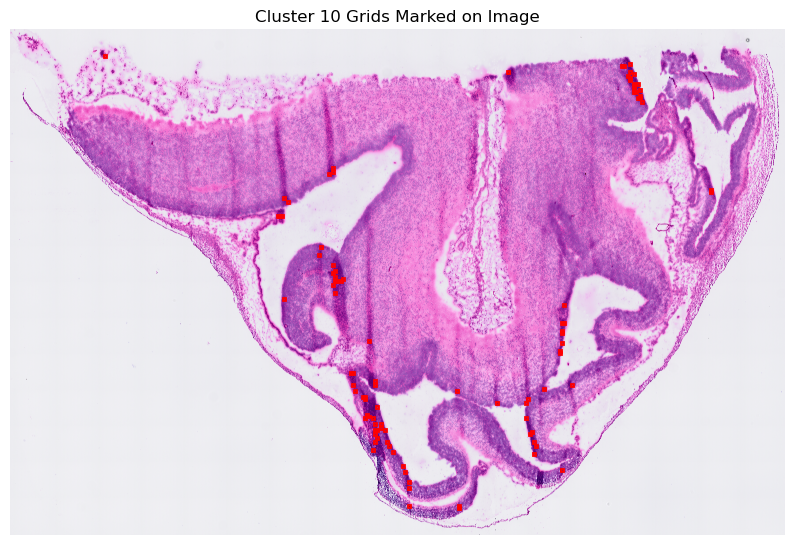

In [28]:
def main():
    file_path = '/mnt/plummergrp/Yutian/Project/SJEA09_C17_head_20x.tiff'
    grid_size = 100
    num_clusters = 50
    background_threshold = 250
    
    image = load_tif_image(file_path)
    grids = split_into_grids(image, grid_size)
    labels = classify_grids(grids, num_clusters=num_clusters, background_threshold=background_threshold)
    
    # Count the number of grids in cluster 10
    cluster_10_count = count_grids_in_cluster(labels, 10)
    print(f"Cluster 10 contains {cluster_10_count} grids.")
    
    if cluster_10_count <= 500:
        # Visualize all grids from cluster 10 if the count is 500 or less
        cluster_10_coords = visualize_cluster_10_in_batches(grids, labels)

        # Mark cluster 10 grids on the original image
        mark_cluster_10_on_image(image, cluster_10_coords, grid_size)
    else:
        print("Cluster 10 contains more than 500 grids, skipping visualization.")

if __name__ == '__main__':
    main()

In [29]:
def visualize_cluster_in_batches(grids, labels, target_cluster, batch_size=50):
    """Visualize all grids from the specified cluster in batches to avoid memory issues."""
    cluster_grids_coords = [(grid[0], grid[2]) for grid, cluster_label in zip(grids, labels) if cluster_label == target_cluster]
    
    num_grids = len(cluster_grids_coords)
    num_batches = math.ceil(num_grids / batch_size)
    
    for batch in range(num_batches):
        batch_grids_coords = cluster_grids_coords[batch * batch_size:(batch + 1) * batch_size]
        cols = 10  # Adjust the number of columns
        rows = math.ceil(len(batch_grids_coords) / cols)
        
        fig, axs = plt.subplots(rows, cols, figsize=(20, 2 * rows))
        fig.suptitle(f"Cluster {target_cluster} - Grids {batch * batch_size + 1} to {(batch + 1) * batch_size}", fontsize=16)
        
        for ax, (grid, coords) in zip(axs.flatten(), batch_grids_coords):
            ax.imshow(grid, cmap='gray')
            ax.axis('off')
            ax.set_title(f"Coords: {coords}", fontsize=8)
        
        for ax in axs.flatten()[len(batch_grids_coords):]:
            ax.axis('off')
        
        plt.tight_layout()
        plt.subplots_adjust(top=0.92)
        plt.show()
    
    return cluster_grids_coords  # Return coordinates for marking on the original image

def mark_cluster_on_image(image, cluster_grids_coords, grid_size, target_cluster):
    """Mark all grids from the specified cluster on the large image."""
    plt.figure(figsize=(10, 10))
    plt.imshow(image, cmap='gray')
    
    for _, coords in cluster_grids_coords:
        start_row, start_col = coords
        rect = plt.Rectangle((start_col, start_row), grid_size, grid_size, edgecolor='red', facecolor='none', lw=2)
        plt.gca().add_patch(rect)
    
    plt.title(f"Cluster {target_cluster} Grids Marked on Image")
    plt.axis('off')
    plt.show()

def count_grids_in_cluster(labels, target_cluster):
    """Count the number of grids in a specific cluster."""
    return sum(1 for label in labels if label == target_cluster)

Cluster 13 contains 59 grids.


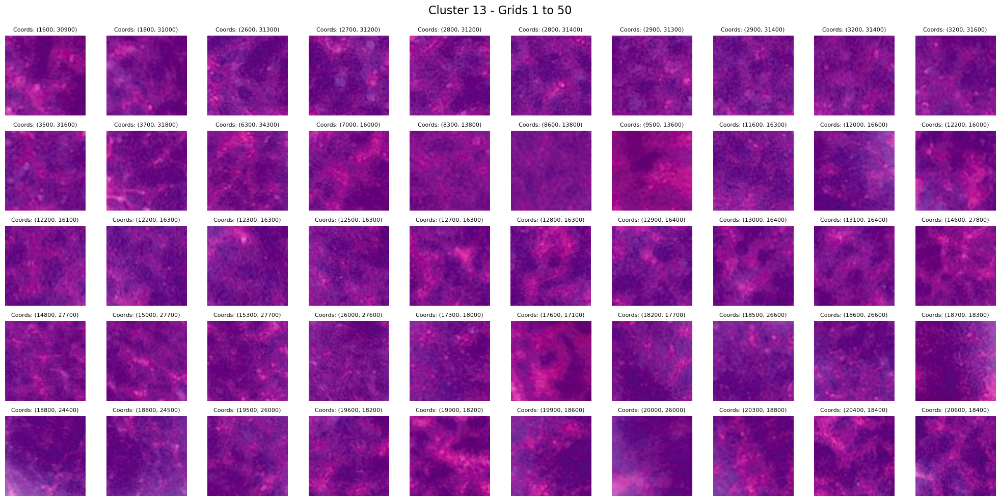

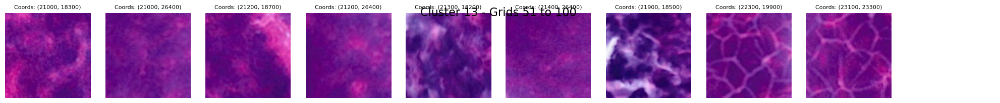

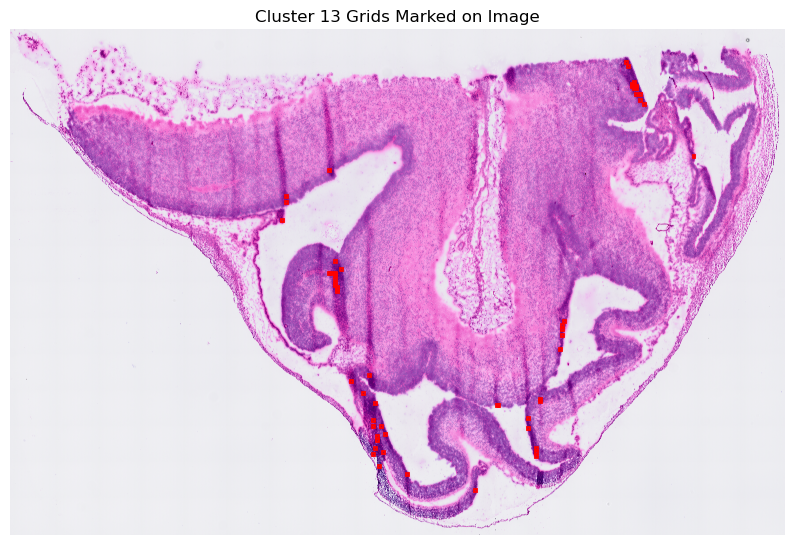

In [30]:
def main():
    file_path = '/mnt/plummergrp/Yutian/Project/SJEA09_C17_head_20x.tiff'
    grid_size = 100
    num_clusters = 70  # Increase this to cover clusters like 20 or 25
    background_threshold = 250
    
    image = load_tif_image(file_path)
    grids = split_into_grids(image, grid_size)
    labels = classify_grids(grids, num_clusters=num_clusters, background_threshold=background_threshold)
    
    # Let the user choose the target cluster
    target_cluster = int(input("Enter the cluster number you want to visualize (e.g., 10, 20, 25): "))
    
    # Count the number of grids in the chosen cluster
    cluster_count = count_grids_in_cluster(labels, target_cluster)
    print(f"Cluster {target_cluster} contains {cluster_count} grids.")
    
    if cluster_count <= 500:
        # Visualize all grids from the chosen cluster if the count is 500 or less
        cluster_coords = visualize_cluster_in_batches(grids, labels, target_cluster)

        # Mark the chosen cluster grids on the original image
        mark_cluster_on_image(image, cluster_coords, grid_size, target_cluster)
    else:
        print(f"Cluster {target_cluster} contains more than 500 grids, skipping visualization.")

if __name__ == '__main__':
    main()

In [31]:
def main():
    file_path = '/mnt/plummergrp/Yutian/Project/SJEA09_C17_head_20x.tiff'
    grid_size = 100
    num_clusters = 200  # Increase this to cover clusters like 20 or 25
    background_threshold = 250
    
    image = load_tif_image(file_path)
    grids = split_into_grids(image, grid_size)
    labels = classify_grids(grids, num_clusters=num_clusters, background_threshold=background_threshold)
    
    # Let the user choose the target cluster
    target_cluster = int(input("Enter the cluster number you want to visualize (e.g., 10, 20, 25): "))
    
    # Count the number of grids in the chosen cluster
    cluster_count = count_grids_in_cluster(labels, target_cluster)
    print(f"Cluster {target_cluster} contains {cluster_count} grids.")
    
    if cluster_count <= 500:
        # Visualize all grids from the chosen cluster if the count is 500 or less
        cluster_coords = visualize_cluster_in_batches(grids, labels, target_cluster)

        # Mark the chosen cluster grids on the original image
        mark_cluster_on_image(image, cluster_coords, grid_size, target_cluster)
    else:
        print(f"Cluster {target_cluster} contains more than 500 grids, skipping visualization.")

if __name__ == '__main__':
    main()

Cluster 150 contains 530 grids.
Cluster 150 contains more than 500 grids, skipping visualization.


Cluster 100 contains 301 grids.


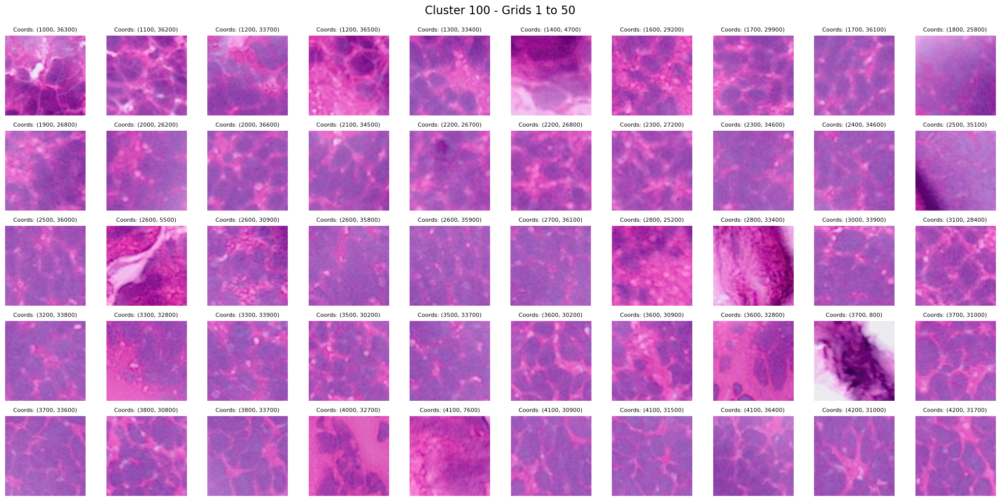

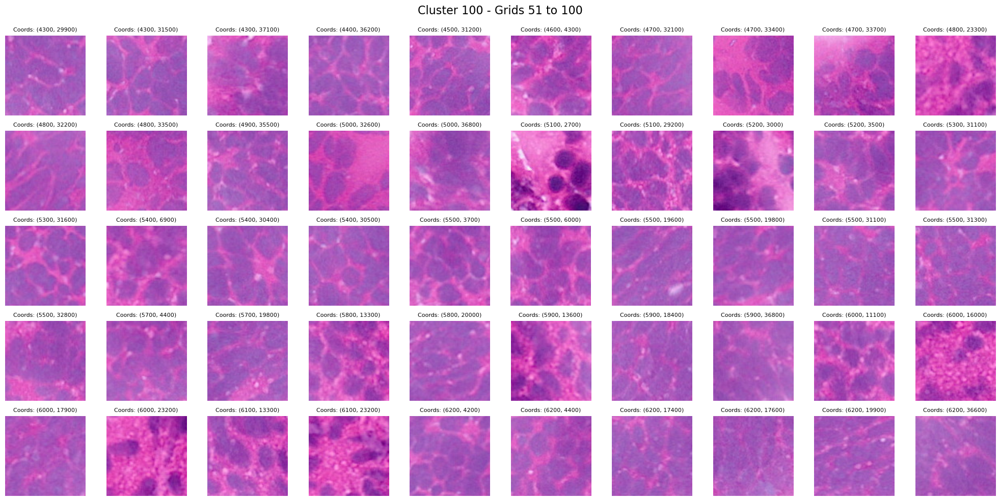

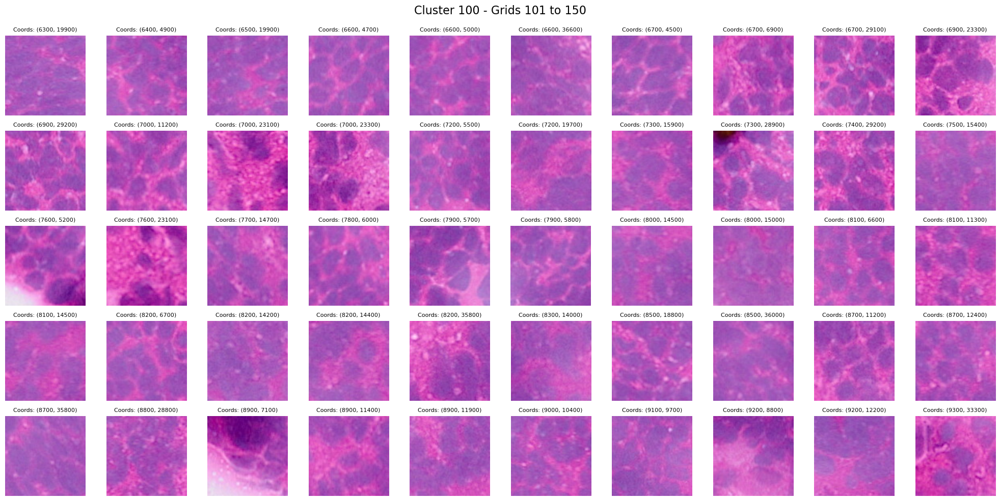

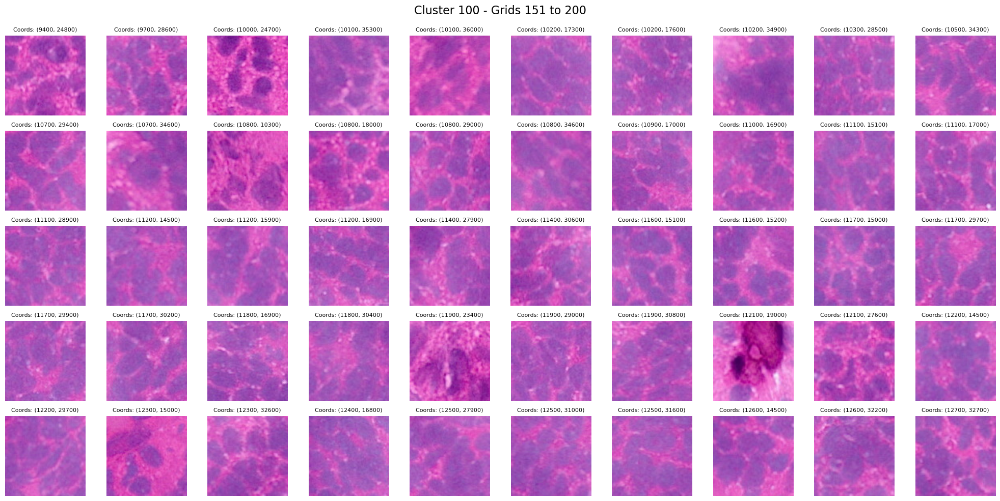

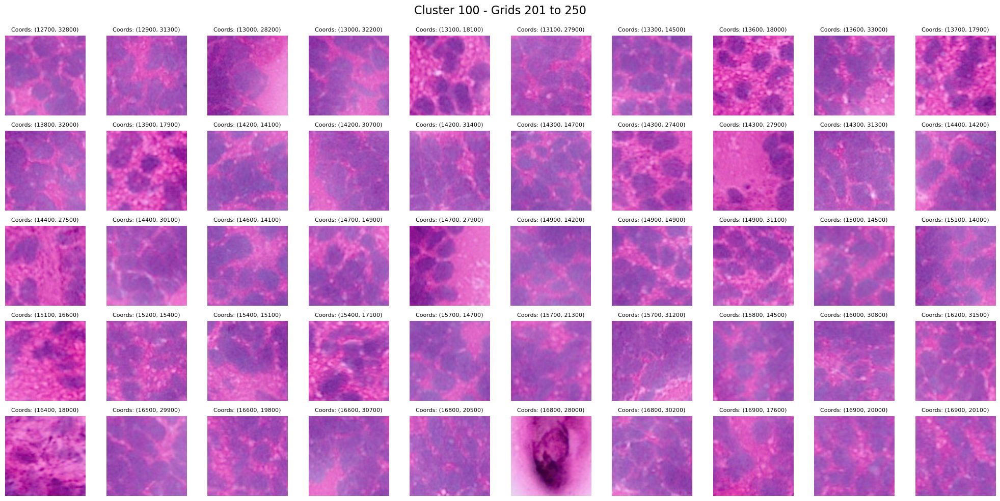

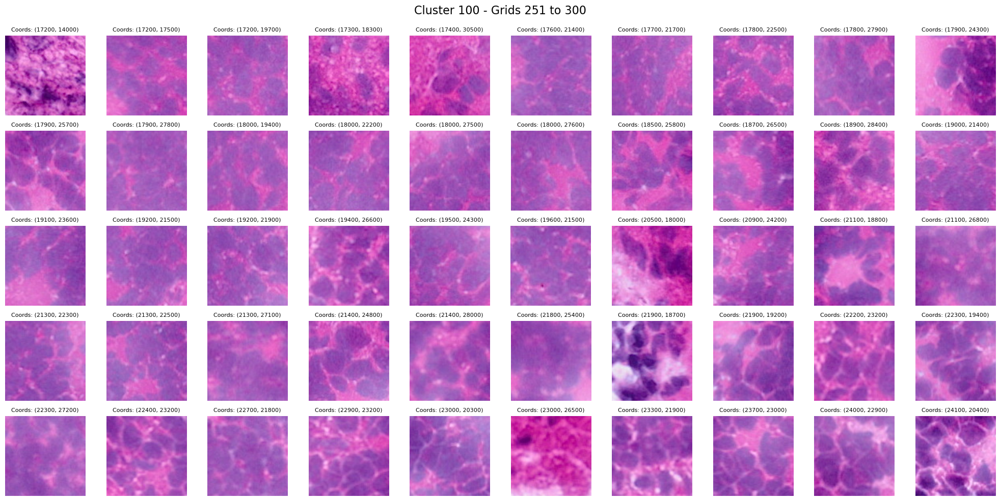

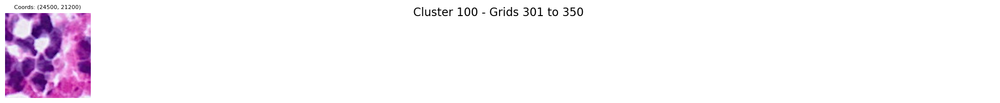

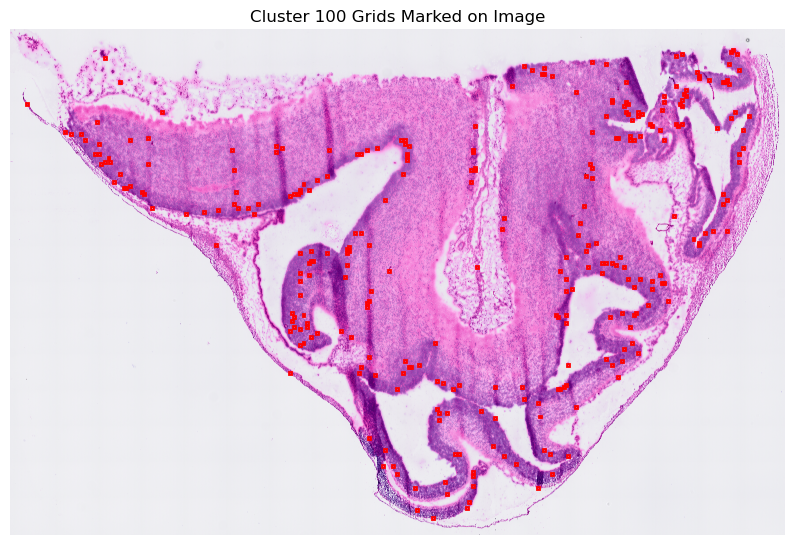

In [33]:
def main():
    file_path = '/mnt/plummergrp/Yutian/Project/SJEA09_C17_head_20x.tiff'
    grid_size = 100
    num_clusters = 200  # Increase this to cover clusters like 20 or 25
    background_threshold = 250
    
    image = load_tif_image(file_path)
    grids = split_into_grids(image, grid_size)
    labels = classify_grids(grids, num_clusters=num_clusters, background_threshold=background_threshold)
    
    # Let the user choose the target cluster
    target_cluster = int(input("Enter the cluster number you want to visualize (e.g., 10, 20, 25): "))
    
    # Count the number of grids in the chosen cluster
    cluster_count = count_grids_in_cluster(labels, target_cluster)
    print(f"Cluster {target_cluster} contains {cluster_count} grids.")
    
    if cluster_count <= 500:
        # Visualize all grids from the chosen cluster if the count is 500 or less
        cluster_coords = visualize_cluster_in_batches(grids, labels, target_cluster)

        # Mark the chosen cluster grids on the original image
        mark_cluster_on_image(image, cluster_coords, grid_size, target_cluster)
    else:
        print(f"Cluster {target_cluster} contains more than 500 grids, skipping visualization.")

if __name__ == '__main__':
    main()

In [36]:
def visualize_cluster_range(grids, labels, target_cluster, start_index=100, end_index=150):
    """Visualize a range of grids from the specified cluster."""
    cluster_grids_coords = [(grid[0], grid[2]) for grid, cluster_label in zip(grids, labels) if cluster_label == target_cluster]
    
    # Ensure the indices are within the bounds
    num_grids = len(cluster_grids_coords)
    start_index = max(0, min(start_index, num_grids - 1))
    end_index = max(0, min(end_index, num_grids))
    
    # Extract the specified range
    range_grids_coords = cluster_grids_coords[start_index:end_index]
    cols = 5  # Adjust the number of columns for display
    rows = math.ceil(len(range_grids_coords) / cols)
    
    fig, axs = plt.subplots(rows, cols, figsize=(4 * cols, 4 * rows))
    fig.suptitle(f"Cluster {target_cluster} - Grids {start_index + 1} to {end_index}", fontsize=16)
    
    for ax, (grid, coords) in zip(axs.flatten(), range_grids_coords):
        ax.imshow(grid, cmap='gray')
        ax.axis('off')
        ax.set_title(f"Coords: {coords}", fontsize=8)
    
    for ax in axs.flatten()[len(range_grids_coords):]:
        ax.axis('off')
    
    plt.tight_layout()
    plt.subplots_adjust(top=0.92)
    plt.show()
    
    return range_grids_coords  # Return coordinates for marking on the original image
def mark_cluster_range_on_image(image, cluster_grids_coords, grid_size, target_cluster):
    """Mark a range of grids from the specified cluster on the large image."""
    plt.figure(figsize=(10, 10))
    plt.imshow(image, cmap='gray')
    
    for _, coords in cluster_grids_coords:
        start_row, start_col = coords
        rect = plt.Rectangle((start_col, start_row), grid_size, grid_size, edgecolor='red', facecolor='none', lw=2)
        plt.gca().add_patch(rect)
    
    plt.title(f"Cluster {target_cluster} Grids Marked on Image")
    plt.axis('off')
    plt.show()

Cluster 660 contains 231 grids.


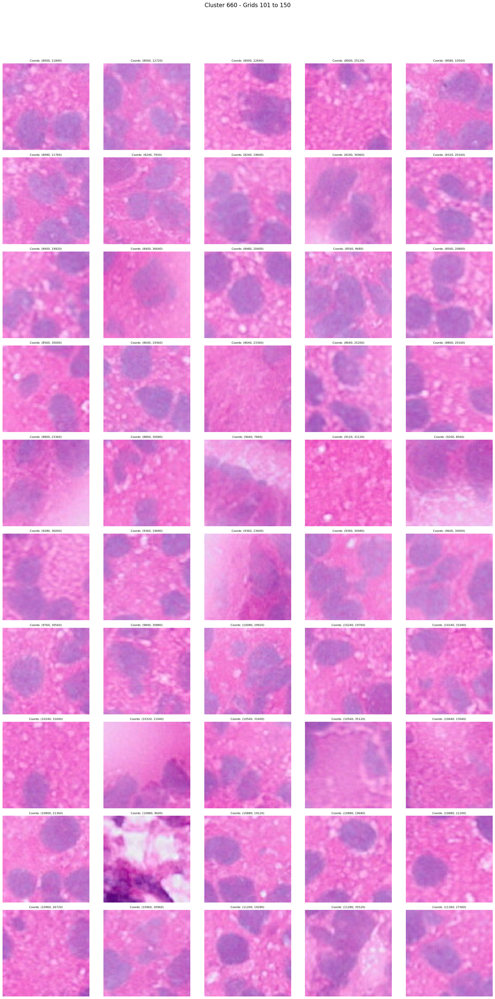

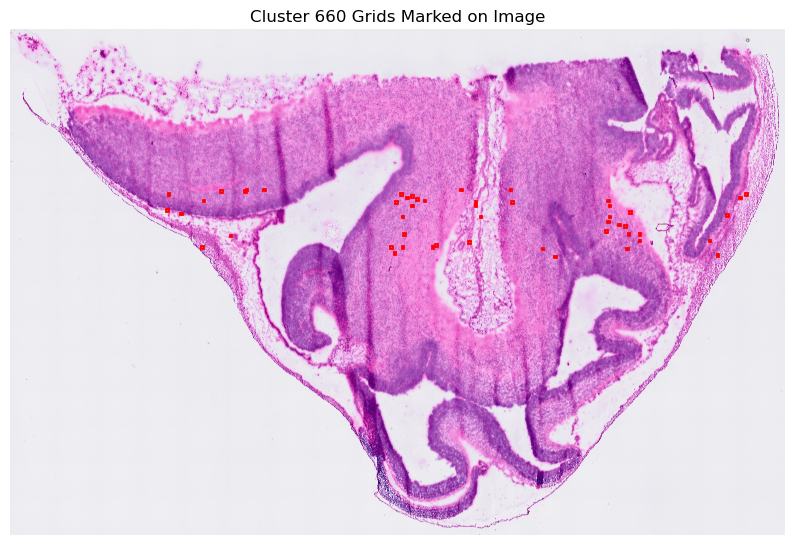

In [38]:
def main():
    file_path = '/mnt/plummergrp/Yutian/Project/SJEA09_C17_head_20x.tiff'
    grid_size = 80
    num_clusters = 950
    background_threshold = 250
    
    image = load_tif_image(file_path)
    grids = split_into_grids(image, grid_size)
    labels = classify_grids(grids, num_clusters=num_clusters, background_threshold=background_threshold)
    
    # Let the user choose the target cluster
    target_cluster = int(input("Enter the cluster number you want to visualize (e.g., 10, 20, 25): "))
    
    # Count the number of grids in the chosen cluster
    cluster_count = count_grids_in_cluster(labels, target_cluster)
    print(f"Cluster {target_cluster} contains {cluster_count} grids.")
    
    if cluster_count > 100:
        # Visualize and mark grids from index 100 to 150 within the chosen cluster
        cluster_coords = visualize_cluster_range(grids, labels, target_cluster, start_index=100, end_index=150)

        # Mark the chosen range of grids on the original image
        mark_cluster_range_on_image(image, cluster_coords, grid_size, target_cluster)
    else:
        print(f"Cluster {target_cluster} contains fewer than 100 grids, cannot visualize the specified range.")

if __name__ == '__main__':
    main()

Specifically, the grids are extracted starting from the top-left corner of the image, moving across each row from left to right, and then proceeding to the next row down, repeating this process until the entire image is covered.

In [39]:
def visualize_cluster_range_coords(grids, labels, target_cluster, start_index=100, end_index=150, coord_bounds=None):
    """Visualize a range of grids from the specified cluster, optionally filtering by coordinates."""
    # Filter grids by target cluster
    cluster_grids_coords = [(grid[0], grid[2]) for grid, cluster_label in zip(grids, labels) if cluster_label == target_cluster]
    
    # Optionally filter grids by coordinate bounds
    if coord_bounds:
        xmin, xmax, ymin, ymax = coord_bounds
        cluster_grids_coords = [(grid, coords) for grid, coords in cluster_grids_coords 
                                if xmin <= coords[1] <= xmax and ymin <= coords[0] <= ymax]
    
    # Ensure the indices are within the bounds
    num_grids = len(cluster_grids_coords)
    start_index = max(0, min(start_index, num_grids - 1))
    end_index = max(0, min(end_index, num_grids))
    
    # Extract the specified range
    range_grids_coords = cluster_grids_coords[start_index:end_index]
    cols = 5  # Adjust the number of columns for display
    rows = math.ceil(len(range_grids_coords) / cols)
    
    fig, axs = plt.subplots(rows, cols, figsize=(4 * cols, 4 * rows))
    fig.suptitle(f"Cluster {target_cluster} - Grids {start_index + 1} to {end_index}", fontsize=16)
    
    for ax, (grid, coords) in zip(axs.flatten(), range_grids_coords):
        ax.imshow(grid, cmap='gray')
        ax.axis('off')
        ax.set_title(f"Coords: {coords}", fontsize=8)
    
    for ax in axs.flatten()[len(range_grids_coords):]:
        ax.axis('off')
    
    plt.tight_layout()
    plt.subplots_adjust(top=0.92)
    plt.show()
    
    return range_grids_coords  # Return coordinates for marking on the original image